<a href="https://colab.research.google.com/github/prakhartiwari10/CV-Projects/blob/main/Floor_plan_assignment.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [30]:
!pip install open3d
import open3d as o3d
import numpy as np
import cv2

In [31]:
path = "/content/Cottage_FREE.stl"
mesh = o3d.io.read_triangle_mesh(path)
pcd = mesh.sample_points_uniformly(number_of_points=100000)
o3d.visualization.draw_plotly([mesh])

In [32]:
o3d.visualization.draw_plotly([pcd])

In [33]:
points = np.asarray(pcd.points)
print(points, points.shape)

[[-5.41395521 -6.08252761  3.18780697]
 [-5.41395521 -6.00963115  1.82176848]
 [-5.41395521 -5.87968295  2.99405966]
 ...
 [ 0.69221072 -4.29691654  4.2014643 ]
 [ 3.64059231 -4.29471861  4.20094236]
 [ 0.42771073 -4.29031997  4.19989382]] (100000, 3)


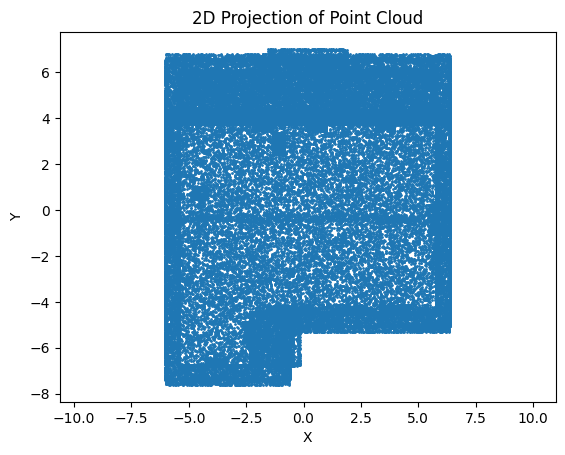

In [34]:
# First approach we can try is only considering x and y points and not z coordinates
# and try plotting it on matplotlib

import matplotlib.pyplot as plt

x_coords = points[:, 0]
y_coords = points[:, 1]

plt.scatter(x_coords, y_coords, s=1)
plt.xlabel('X')
plt.ylabel('Y')
plt.title('2D Projection of Point Cloud')
plt.axis('equal')
plt.show()

## Problems:
* This looks good, but I saw a real floor plan image, there is more
information including different rooms, windows, etc.
* We are losing information of depth which 3d image gives us using this approach I think.
* Also there might be some noise, so we should reduce noise, like given in documentation of open3d.
* Also this house is not good to take in example because it does not have lot of rooms and  doors and just have a single room.
## Solution:
* First load a different 3d image with big house for example.
* Remove noise and then segment the 3d image and then project it into 2d.

In [35]:
house_path = "/content/modell_new_house_stl.stl"
mesh = o3d.io.read_triangle_mesh(house_path)
o3d.visualization.draw_plotly([mesh])

In [36]:
pcd = mesh.sample_points_uniformly(number_of_points=100000)
o3d.visualization.draw_plotly([pcd])

In [37]:
# Let's work with triangle mesh instead of point cloud, so that we can extract edges.
# To extract edges, we use set to avoid duplicate values. Since this is triangles, the edges will be something like 0-1, 1-2 and 2-0
# So to extract edges, we will make a tuple of edges after sorting the vertex indices to ensure the edge is stored in a consistent order (e.g., (1, 3) instead of (3, 1)).
edges = set()
triangles = np.asarray(mesh.triangles)
vertices = np.asarray(mesh.vertices)
for triangle in triangles:
  for i in range(3):
    edge = tuple(sorted((triangle[i], triangle[(i + 1) % 3])))
    edges.add(edge)

In [38]:
# Now we will project 3d edges into 2d. To do this, we do similar in the previous approach, ignore z-coodinate.
scale_factor=10
projected_edges = []
for edge in edges:
  pt1 = vertices[edge[0]][:2] * scale_factor
  pt2 = vertices[edge[1]][:2] * scale_factor
  projected_edges.append((pt1, pt2))

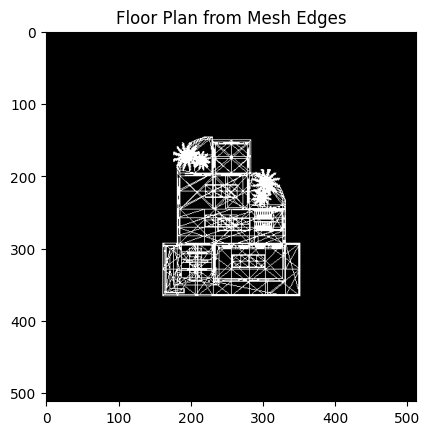

In [39]:
# Now we want to build the image, by initializint the image by np.zeros
image_size=(512, 512)
floor_plan= np.zeros(image_size, dtype=np.uint8)

# Determine center coordinates which helps in transforming

center_x, center_y = image_size[1] // 2, image_size[0] // 2
for edge in projected_edges:
  pt1 = (int(edge[0][0]) + center_x, center_y - int(edge[0][1]))
  pt2 = (int(edge[1][0]) + center_x, center_y - int(edge[1][1]))
# Draw the edge on theimage

  cv2.line(floor_plan, pt1, pt2, 255, 1)

plt.imshow(floor_plan, cmap='gray')
plt.title('Floor Plan from Mesh Edges')
plt.show()

## Problems with this:
* Image includes more lines than what would be desired for a floor plan.
* This is maybe because the image includes internal structural edges, not just the outer boundary edges of the mesh.

## Solution:
* we need to focus on extracting the outer boundary edges of the 3D structure, while ignoring the internal edges.
* GPT suggests this:
* Calculate the convex hull of the 2D projected points to get the outermost boundary.
* Use an alpha shape (a generalization of the convex hull) to capture the outer boundary with concavities.
* Simplify the mesh before projecting to reduce the number of internal edges.
(Reminder - Study about convex hull and Alpha Shape!!!)
* After trying, this method didn't work, have to try something else.

## New Solution:
* If we instead of ignoring all the z-vertices like in the first approach, limit the number or vertices (like a threshold) so that the roof of the house will be gone, then we can project that into the floor and have like a birds eye view.

In [40]:
# Make a function to threshold the z
def filter_vertices(mesh, z_threshold):
    vertices = np.asarray(mesh.vertices)
    triangles = np.asarray(mesh.triangles)

    # Create a mask to filter out vertices above the Z threshold
    mask = vertices[:, 2] < z_threshold
    filtered_vertices = vertices[mask]

    # Filter triangles that have all vertices below the threshold
    filtered_triangles = [triangle for triangle in triangles if all(mask[triangle])]

    # Create a new mesh with filtered vertices and triangles
    filtered_mesh = o3d.geometry.TriangleMesh()
    filtered_mesh.vertices = o3d.utility.Vector3dVector(filtered_vertices)
    filtered_mesh.triangles = o3d.utility.Vector3iVector(filtered_triangles)

    return filtered_mesh

z_threshold = 20.0
filtered_mesh = filter_vertices(mesh, z_threshold)
o3d.visualization.draw_plotly([filtered_mesh])

In [41]:
def project_vertices_to_2d(mesh, scale_factor=10):
    vertices = np.asarray(mesh.vertices)
    projected_vertices = vertices[:, :2] * scale_factor
    return projected_vertices

projected_vertices = project_vertices_to_2d(filtered_mesh)

In [42]:
def project_edges_to_2d(edges, vertices, scale_factor=10):
    projected_edges = []
    for edge in edges:
        pt1 = vertices[edge[0]][:2] * scale_factor
        pt2 = vertices[edge[1]][:2] * scale_factor
        projected_edges.append((pt1, pt2))
    return projected_edges

projected_edges = project_edges_to_2d(edges, vertices)


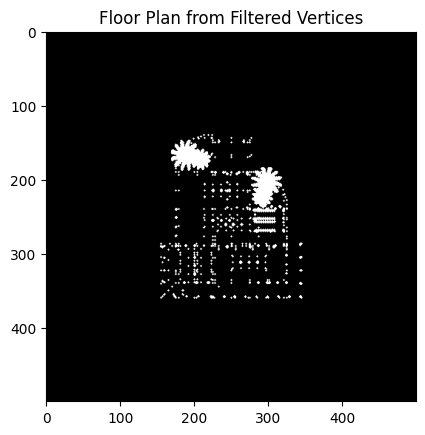

Floor plan saved to filtered_vertices_floor_plan.png


In [43]:
def create_floor_plan_image(vertices, image_size=(500, 500), point_size=1):
    floor_plan = np.zeros(image_size, dtype=np.uint8)
    center_x, center_y = image_size[1] // 2, image_size[0] // 2

    for vertex in vertices:
        pt = (int(vertex[0]) + center_x, center_y - int(vertex[1]))
        cv2.circle(floor_plan, pt, point_size, 255, -1)

    return floor_plan


floor_plan_image = create_floor_plan_image(projected_vertices)

# Display the image
plt.imshow(floor_plan_image, cmap='gray')
plt.title('Floor Plan from Filtered Vertices')
plt.show()

# Save the image
output_path = 'filtered_vertices_floor_plan.png'
cv2.imwrite(output_path, floor_plan_image)
print(f"Floor plan saved to {output_path}")

## Final thoughts:
This solution didn't work that well as the previous one, I think that maybe the previous method will give better results if we try it in different image.
I couldn't find another good image in the internet to download in the right format.